# <b><font size=7 color='orange'> Computer Assignment 1 - Task 2 </font></b>

<b><font color="orange" size="6">Collaborators:</font></b><br>
<font color="orange" size="5">
  <i>
     Mehrad Liviyan - 810101501<br>
     Shayan Saeedi - 810101442
  </i>
</font>


## Install Libraries

In [1]:
!pip install opencv-python

## Load Image

Image loaded successfully


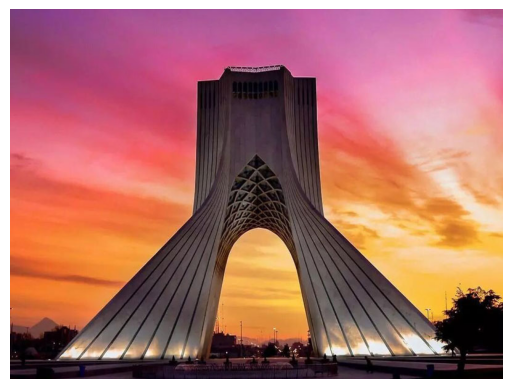

Data type: uint8
Shape: (600, 800, 3)
Number of color channels: 3


In [2]:
import cv2
from matplotlib import pyplot as plt
import numpy as np
from scipy.signal import convolve2d

image = cv2.imread("/content/drive/MyDrive/Computer Vision - F04/CA1/Description/Pic.jpg")
if image is None:
    print("Error: Image not found or path is incorrect")
else:
    rgb_image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    print("Image loaded successfully")
    plt.imshow(rgb_image)
    plt.axis("off")
    plt.show()
    print("Data type:", image.dtype)
    print("Shape:", image.shape)
    if len(image.shape) == 3:
        print("Number of color channels:", image.shape[2])
    else:
        print("Grayscale image (1 channel)")




## salt and pepper noise

<div dir="rtl">

* به صورت پیکسل‌های سفید و سیاه که به‌صورت تصادفی روی تصویر پاشیده شده‌اند دیده می‌شود.

* شبیه «نمک» (نقاط سفید) و «فلفل» (نقاط سیاه).

* معمولاً بر اثر اختلال لحظه‌ای در سنسورهای تصویر یا خطا در انتقال داده به‌وجود می‌آید.


* هر پیکسل با احتمال کوچک
𝑝
p به مقدار ۰ (سیاه) یا ۲۵۵ (سفید) تبدیل می‌شود.

* سایر پیکسل‌ها بدون تغییر باقی می‌مانند.

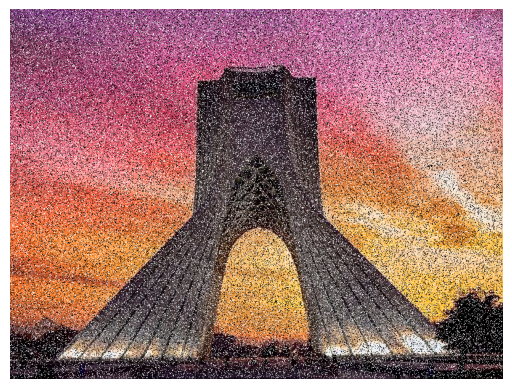

In [3]:

def add_salt_and_pepper_noise(image, salt_prob=0.1, pepper_prob=0.1):
    noisy_image = image.copy()
    total_pixels = noisy_image.size

    num_salt = int(total_pixels * salt_prob)
    salt_coords = [np.random.randint(0, i-1, num_salt) for i in noisy_image.shape]
    noisy_image[salt_coords[0], salt_coords[1]] = 255

    num_pepper = int(total_pixels * pepper_prob)
    pepper_coords = [np.random.randint(0, i-1, num_pepper) for i in noisy_image.shape]
    noisy_image[pepper_coords[0], pepper_coords[1]] = 0

    return noisy_image



salt_and_pepper_noisy_image = add_salt_and_pepper_noise(rgb_image, 0.05, 0.05)

plt.imshow(salt_and_pepper_noisy_image, cmap='gray')
plt.axis('off')
plt.show()


## Gaussian noise

<div dir="rtl">


* نویز تصادفی که از **توزیع نرمال / Gaussian** پیروی می‌کند.
* بیشتر مقدار روشنایی پیکسل‌ها کمی و در اطراف مقدار اصلی تغییر می‌کند.
* معمولاً در نویز سنسورها هنگام ثبت تصویر رخ می‌دهد.


$$[
I_{noisy} = I_{original} + N(0, \sigma^2)
]$$

که در آن:

* $( N(0, \sigma^2) )$ نویز گوسی با میانگین ۰ و انحراف معیار $( \sigma )$ است.


* σ کوچک → تغییرات کم، نویز خفیف
* σ بزرگ → تغییرات زیاد، نویز شدید

مقدارهای معمول برای تصاویر 8 بیتی (بازه 255–0):

| مقدار σ | مقدار نویز |
| ------- | ---------- |
| 5–15    | نویز کم    |
| 20–50   | نویز متوسط |
| > 50    | نویز زیاد  |


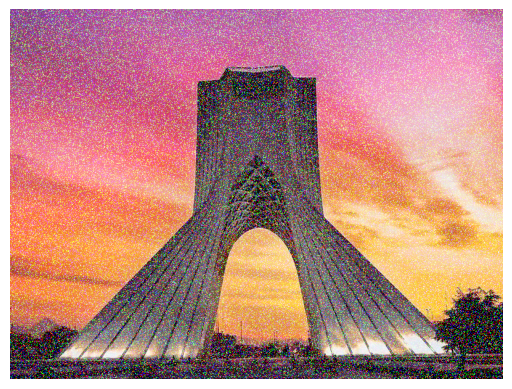

In [4]:
def add_gaussian_noise(image, mean=0, sigma=25):
    gauss = np.random.normal(mean, sigma, image.shape).astype('uint8')
    noisy = cv2.add(image, gauss)  # add noise to image
    return noisy

gaussian_noisy_image = add_gaussian_noise(rgb_image, mean=0, sigma=1)

plt.imshow(gaussian_noisy_image, cmap='gray')
plt.axis('off')
plt.show()


## Kernel

<div dir="rtl">
در پردازش تصویر، کرنل (Kernel) یا فیلتر یک ماتریس کوچک (آرایهٔ دوبعدی) است که با استفاده از فرایندی به نام (Convolution) روی تصویر اعمال می‌شود.
کرنل برای انجام کارهایی مثل تاری‌کردن تصویر، شارپ‌کردن، تشخیص لبه و ... استفاده می‌شود.

* اندازهٔ کرنل معمولاً بسیار کوچک‌تر از تصویر است (مثل ماتریس 3×3 یا 5×5 یا 7×7).
* کرنل روی تصویر پیکسل به پیکسل حرکت می‌کند و روی پیکسل‌های زیر خود عملیات ریاضی انجام می‌دهد.
* این عملیات معمولاً به صورت جمع وزن‌دار مقادیر پیکسل‌ها است.

فرمول ریاضی (Convolution):

خروجی در مکان (i, j) به این صورت محاسبه می‌شود:

$$[
Output(i, j) = \sum_{m=-k}^{k} \sum_{n=-k}^{k} Kernel(m, n) \times Image(i + m, j + n)
]$$

که در آن:

* ( k ) نصف اندازهٔ کرنل است (مثلاً برای کرنل 3×3، مقدار ( k = 1 )).

خلاصهٔ کاربردهای انواع کرنل‌ها:

| نوع کرنل                                  | هدف / عملکرد                                      | کاربرد                                        |
| ----------------------------------------- | ------------------------------------------------- | --------------------------------------------- |
| **Identity (هویتی)**                      | هیچ تغییری روی تصویر ایجاد نمی‌کند                | حالت پایه، تست                                |
| **Box Blur (تاری ساده)**                  | صاف‌کردن تصویر، کاهش نویز                         | کاهش نویز، محو‌کردن تصویر                     |
| **Gaussian Blur (تاری گوسی)**             | صاف‌کردن با وزن‌دهی بیشتر به پیکسل‌های نزدیک مرکز | حذف نویز فرکانس بالا، نرم‌کردن طبیعی          |


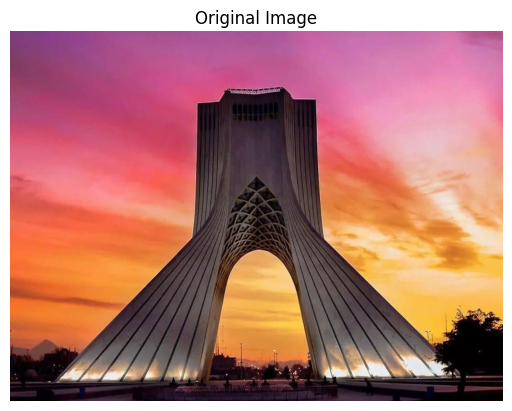

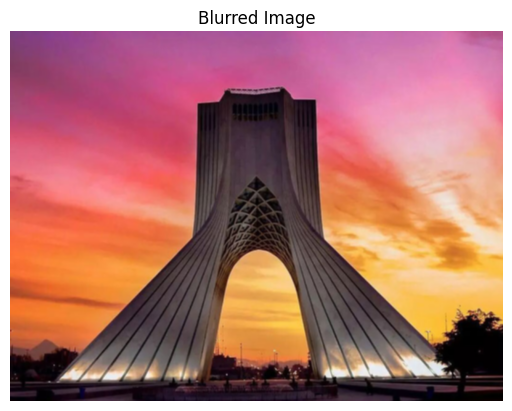

In [5]:
kernel = np.array([[1, 1, 1], [1, 1, 1], [1, 1, 1]]) / 9  # Box Blur

blurred_image = cv2.filter2D(rgb_image, -1, kernel)


plt.imshow(rgb_image)
plt.axis("off")
plt.title("Original Image")
plt.show()

plt.imshow(blurred_image)
plt.axis('off')
plt.title("Blurred Image")
plt.show()


## Mean Filter

<div dir="rtl">

مفهوم:

* فیلتر میانگین تصویر را صاف (Smooth) می‌کند، به این صورت که هر پیکسل با میانگین پیکسل‌های همسایگی‌اش جایگزین می‌شود.
* این یک فیلتر خطی است، یعنی از ترکیب خطی مقادیر پیکسل‌ها استفاده می‌کند.
* هدف: کاهش نویز تصادفی (مثل نویز گوسی) با میانگین‌گیری تغییرات کوچک شدت پیکسل‌ها.

نمونه کرنل:

برای فیلتر میانگین ۳×۳:

$$[ K_{mean} = \frac{1}{9} \begin{bmatrix} 1 & 1 & 1 \newline 1 & 1 & 1 \newline 1 & 1 & 1 \end{bmatrix} ]$$

* چگونگی عملکرد: مقدار هر پیکسل با میانگین ۳×۳ پیکسل‌های اطراف آن جایگزین می‌شود.
* اثر: نویزهای کوچک را صاف می‌کند اما لبه‌ها را محو می‌کند، چون تفاوت بین نویز و جزئیات تصویر را تشخیص نمی‌دهد.

فرمول ریاضی:



$$[
I_{new}(x, y) = \frac{1}{N^2} \sum_{i=-k}^{k} \sum_{j=-k}^{k} I(x+i, y+j)
]$$

که در آن:

* ( I(x, y) ) = شدت پیکسل اصلی در موقعیت (x, y)
* ( N ) = اندازه کرنل (برای کرنل ۳×۳، N=3)
* مجموع پیکسل‌های همسایگی تقسیم بر تعداد کل پیکسل‌ها در کرنل می‌شود.


خلاصه:
 خطی، یکنواخت - کاهش نویز تصادفی - ساده، کاهش نویز گوسی                            - محو کردن لبه‌ها          



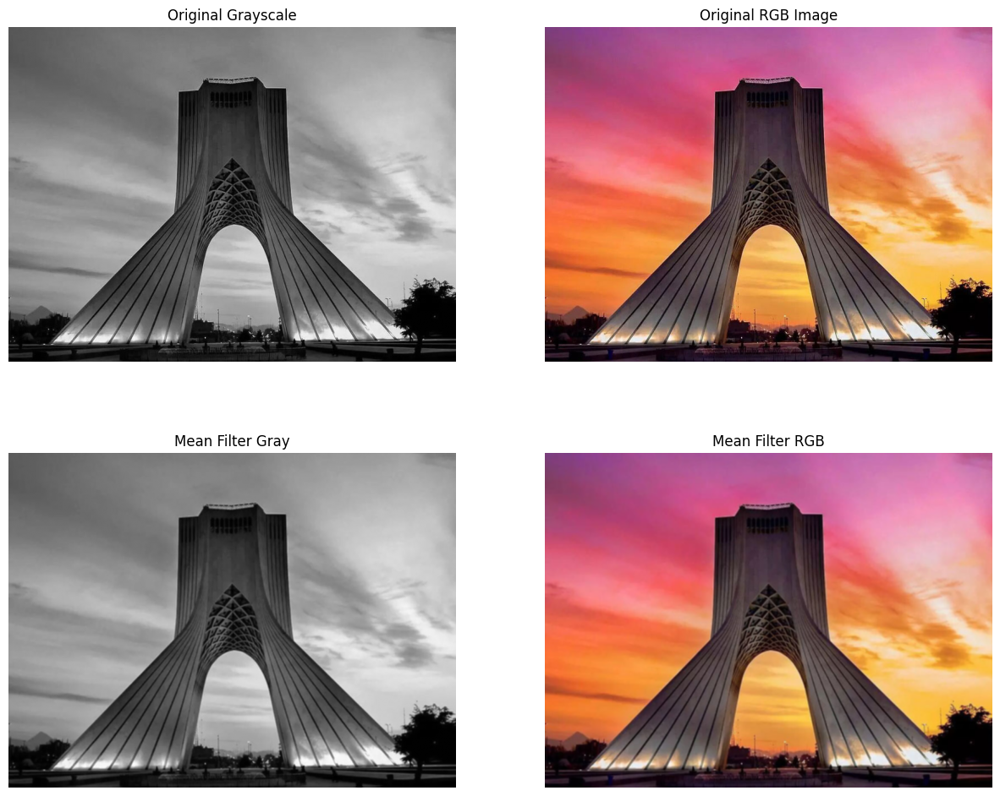

In [6]:
mean_gray = cv2.blur(gray_image, (3, 3))
mean_rgb = cv2.blur(rgb_image, (3, 3))


plt.figure(figsize=(15, 12))
plt.subplot(2, 2, 1)
plt.imshow(gray_image, cmap='gray')
plt.title("Original Grayscale")
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(rgb_image, cmap='gray')
plt.title("Original RGB Image")
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(mean_gray, cmap='gray')
plt.title("Mean Filter Gray")
plt.axis('off')


plt.subplot(2, 2, 4)
plt.imshow(mean_rgb)
plt.title("Mean Filter RGB")
plt.axis('off')
plt.show()


### Manual

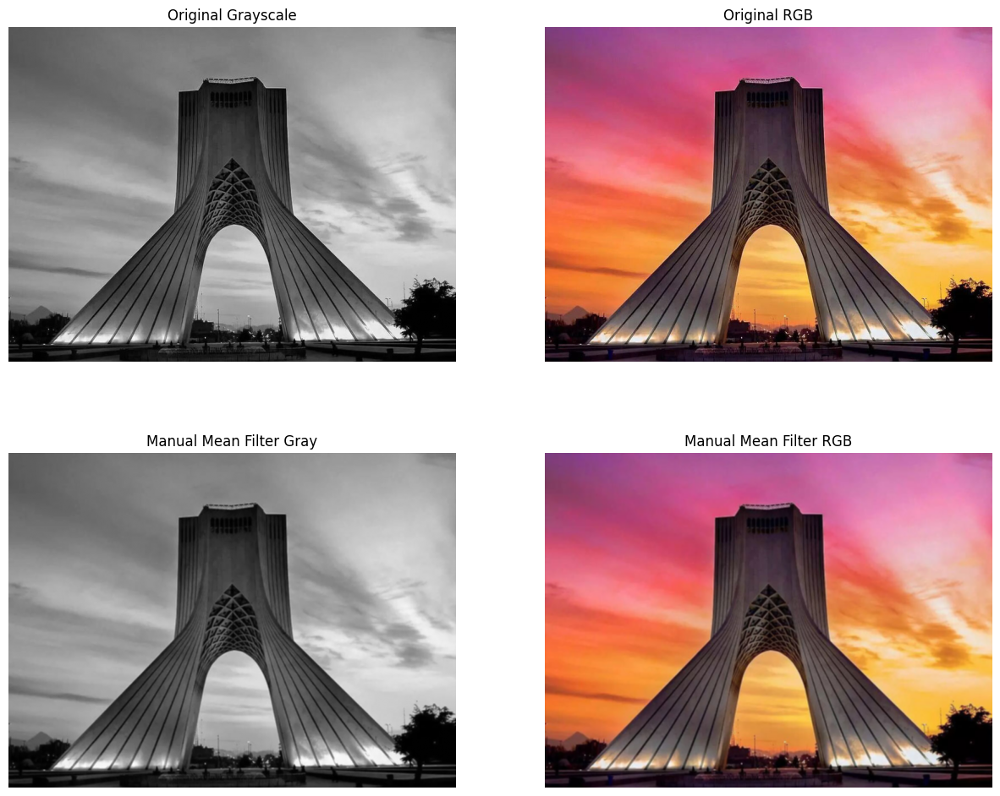

In [7]:
def manual_mean_filter_gray(image, ksize=3):
    pad = ksize // 2
    padded = np.pad(image, pad, mode='edge')
    output = np.zeros_like(image)

    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            # extract the neighborhood
            region = padded[i:i+ksize, j:j+ksize]
            output[i, j] = np.mean(region)  # compute mean
    return output

def manual_mean_filter_rgb(image, ksize=3):
    output = np.zeros_like(image)
    for c in range(3):
        output[:, :, c] = manual_mean_filter_gray(image[:, :, c], ksize)
    return output

mean_gray_manual = manual_mean_filter_gray(gray_image, 3)
mean_rgb_manual = manual_mean_filter_rgb(rgb_image, 3)

plt.figure(figsize=(15, 12))

plt.subplot(2, 2, 1)
plt.imshow(gray_image, cmap='gray')
plt.title("Original Grayscale")
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(rgb_image.astype(np.uint8))
plt.title("Original RGB")
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(mean_gray_manual, cmap='gray')
plt.title("Manual Mean Filter Gray")
plt.axis('off')

plt.subplot(2, 2, 4)
plt.imshow(mean_rgb_manual.astype(np.uint8))
plt.title("Manual Mean Filter RGB")
plt.axis('off')

plt.show()


## Gaussian Filter

<div dir="rtl">
مفهوم:

* شبیه فیلتر میانگین است اما میانگین وزن‌دار استفاده می‌کند و به پیکسل‌های نزدیک مرکز وزن بیشتری می‌دهد.
* این هم یک فیلتر خطی است، اما نسبت به میانگین لبه‌ها را بهتر حفظ می‌کند چون پیکسل‌های دور وزن کمتری دارند.

نمونه کرنل ۳×۳:

$$[
K_{gaussian} = \frac{1}{16}
\begin{bmatrix}
1 & 2 & 1 \newline
2 & 4 & 2 \newline
1 & 2 & 1
\end{bmatrix}
]$$

* σ (سیگما): تعیین‌کننده پراکندگی گوسی است؛ σ بزرگ‌تر → صاف‌سازی قوی‌تر.
* اثر: نویز را محو می‌کند و ساختار و لبه‌های تصویر را بهتر از فیلتر میانگین حفظ می‌کند.

فرمول ریاضی:

$$[
G(x, y) = \frac{1}{2 \pi \sigma^2} e^{-\frac{x^2 + y^2}{2\sigma^2}}
]$$

* هر پیکسل با مجموع وزن‌دار پیکسل‌های همسایه جایگزین می‌شود، به طوری که همسایه‌های نزدیک‌تر وزن بیشتری دارند.


خلاصه:
خطی، وزن‌دار - کاهش نویز گوسی - لبه‌ها را بهتر حفظ می‌کند                       - کمی محو شدن             

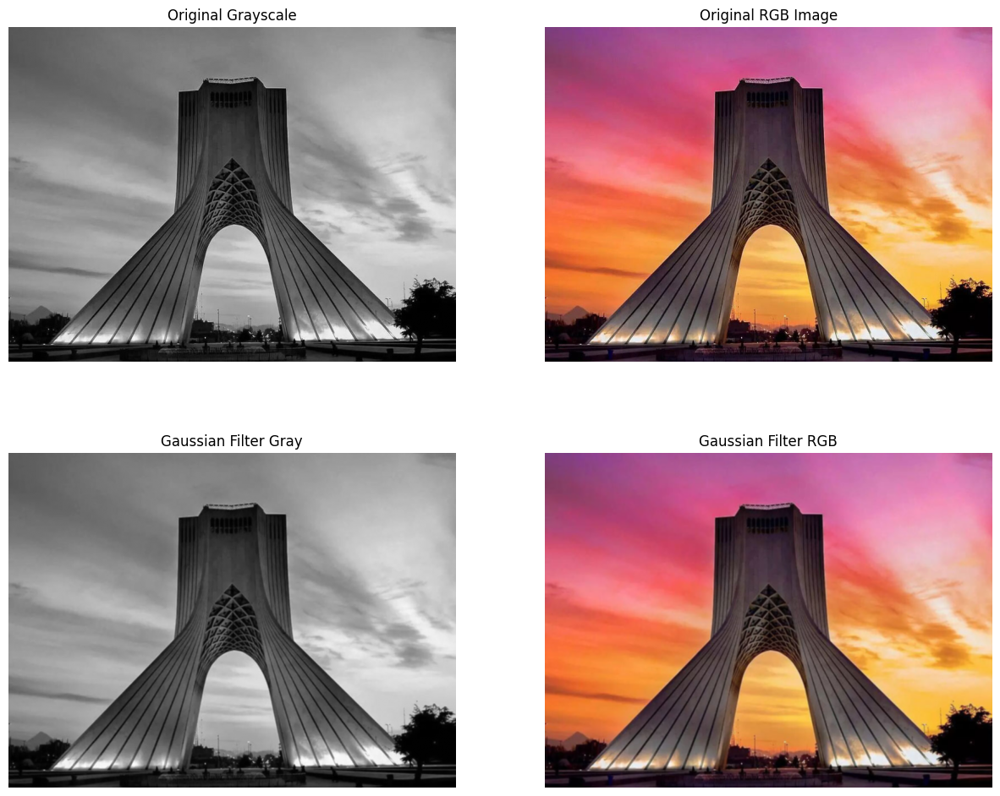

In [8]:
gaussian_gray = cv2.GaussianBlur(gray_image, (3, 3), sigmaX=1)
gaussian_rgb = cv2.GaussianBlur(rgb_image, (3, 3), sigmaX=1)

plt.figure(figsize=(15, 12))
plt.subplot(2, 2, 1)
plt.imshow(gray_image, cmap='gray')
plt.title("Original Grayscale")
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(rgb_image, cmap='gray')
plt.title("Original RGB Image")
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(gaussian_gray, cmap='gray')
plt.title("Gaussian Filter Gray")
plt.axis('off')


plt.subplot(2, 2, 4)
plt.imshow(gaussian_rgb)
plt.title("Gaussian Filter RGB")
plt.axis('off')
plt.show()


### Manual

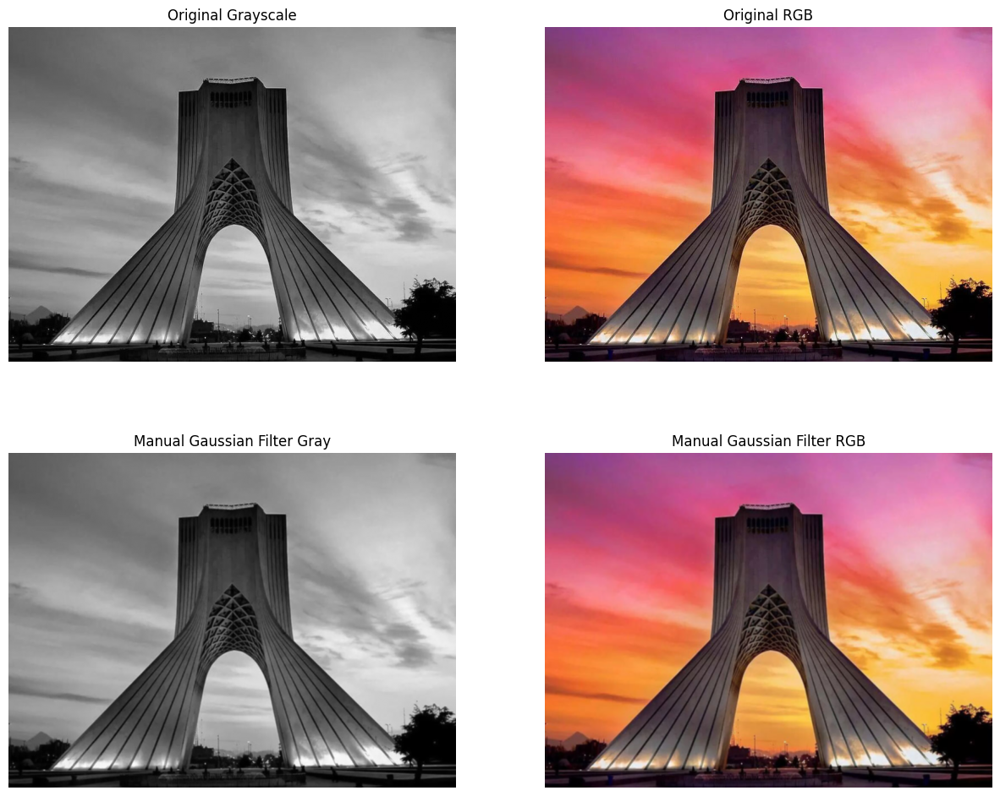

In [9]:
def gaussian_kernel(size=3, sigma=1):
    """Generate a 2D Gaussian kernel."""
    ax = np.arange(-size // 2 + 1., size // 2 + 1.)
    xx, yy = np.meshgrid(ax, ax)
    kernel = np.exp(-(xx**2 + yy**2) / (2. * sigma**2))
    return kernel / np.sum(kernel)

kernel_gaussian = gaussian_kernel(3, sigma=1)

def manual_filter_gray(image, kernel):
    ksize = kernel.shape[0]
    pad = ksize // 2
    padded = np.pad(image, pad, mode='edge')
    output = np.zeros_like(image)

    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            region = padded[i:i+ksize, j:j+ksize]
            output[i, j] = np.sum(region * kernel)
    return output

def manual_filter_rgb(image, kernel):
    output = np.zeros_like(image)
    for c in range(3):
        output[:, :, c] = manual_filter_gray(image[:, :, c], kernel)
    return output

gaussian_gray_manual = manual_filter_gray(gray_image, kernel_gaussian)
gaussian_rgb_manual = manual_filter_rgb(rgb_image, kernel_gaussian)

plt.figure(figsize=(15, 12))

plt.subplot(2, 2, 1)
plt.imshow(gray_image, cmap='gray')
plt.title("Original Grayscale")
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(rgb_image.astype(np.uint8))
plt.title("Original RGB")
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(gaussian_gray_manual, cmap='gray')
plt.title("Manual Gaussian Filter Gray")
plt.axis('off')

plt.subplot(2, 2, 4)
plt.imshow(gaussian_rgb_manual.astype(np.uint8))
plt.title("Manual Gaussian Filter RGB")
plt.axis('off')

plt.show()


## Median Filter

<div dir="rtl">

مفهوم:

* فیلتر میانه هر پیکسل را با مقدار میانه پیکسل‌های همسایگی‌اش جایگزین می‌کند.
* این یک فیلتر غیرخطی است، برخلاف میانگین و گوسی.
* هدف حذف نویز نمک و فلفل (Salt & Pepper) بدون محو کردن لبه‌ها.

نمونه کرنل ۳×۳:

* تمام ۹ پیکسل پنجره ۳×۳ را مرتب کرده و میانه را انتخاب می‌کنیم.

| 120 | 125 | 130 |
| 118 | 255 | 121 |
| 119 | 122 | 124 |

* میانه = 122 → جایگزین پیکسل مرکز می‌شود.

* اثر: لبه‌ها بهتر حفظ می‌شوند چون مقادیر افراطی را نادیده می‌گیرد (برخلاف میانگین که آنها را میانگین می‌کند).


خلاصه:
غیرخطی       - نویز نمک و فلفل - لبه‌ها را حفظ می‌کند، مقادیر افراطی حذف می‌شوند - برای نویز گوسی کم‌اثر است


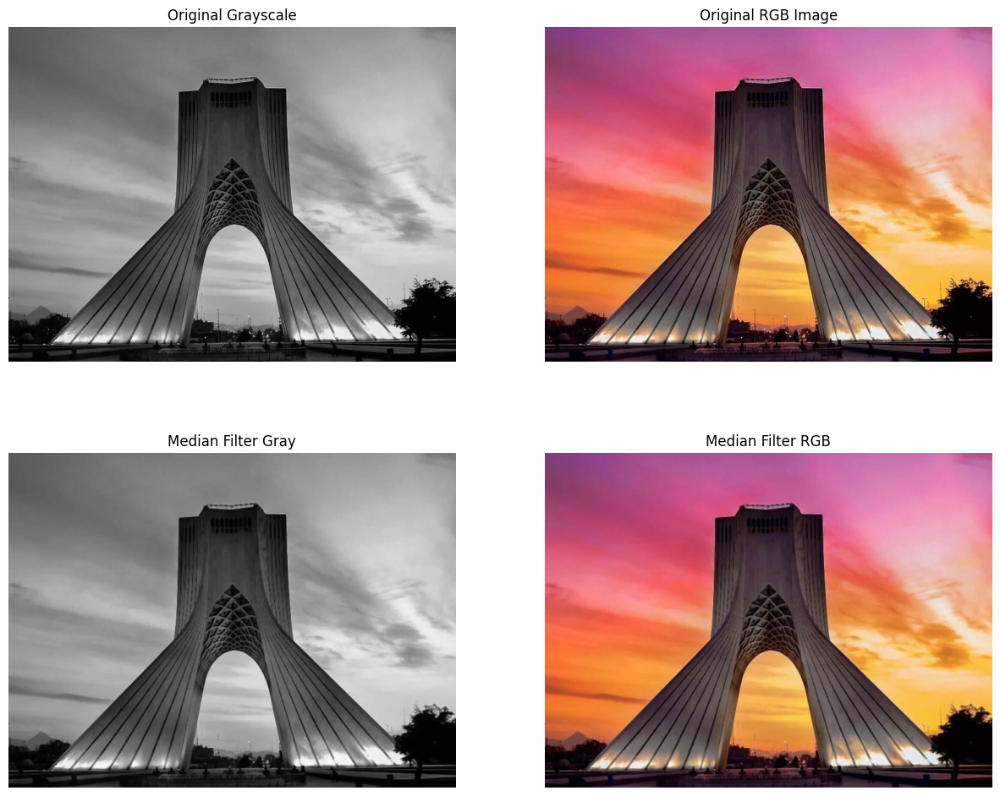

In [10]:
median_gray = cv2.medianBlur(gray_image, 3)
median_rgb = cv2.medianBlur(rgb_image, 3)

plt.figure(figsize=(15, 12))
plt.subplot(2, 2, 1)
plt.imshow(gray_image, cmap='gray')
plt.title("Original Grayscale")
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(rgb_image, cmap='gray')
plt.title("Original RGB Image")
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(median_gray, cmap='gray')
plt.title("Median Filter Gray")
plt.axis('off')


plt.subplot(2, 2, 4)
plt.imshow(median_rgb)
plt.title("Median Filter RGB")
plt.axis('off')
plt.show()


### Manual

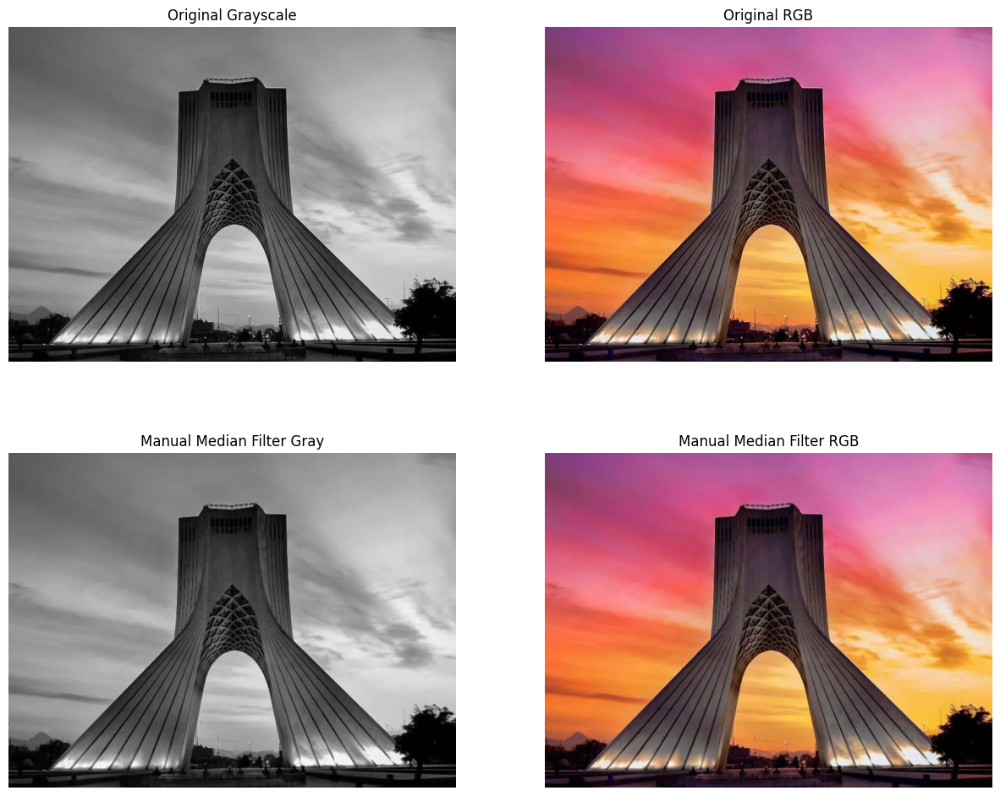

In [11]:
def manual_median_filter_gray(image, ksize=3):
    pad = ksize // 2
    padded = np.pad(image, pad, mode='edge')
    output = np.zeros_like(image)

    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            region = padded[i:i+ksize, j:j+ksize]
            output[i, j] = np.median(region)
    return output

def manual_median_filter_rgb(image, ksize=3):
    output = np.zeros_like(image)
    for c in range(3):
        output[:, :, c] = manual_median_filter_gray(image[:, :, c], ksize)
    return output

median_gray_manual = manual_median_filter_gray(gray_image, 3)
median_rgb_manual = manual_median_filter_rgb(rgb_image, 3)

plt.figure(figsize=(15, 12))

plt.subplot(2, 2, 1)
plt.imshow(gray_image, cmap='gray')
plt.title("Original Grayscale")
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(rgb_image.astype(np.uint8))
plt.title("Original RGB")
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(median_gray_manual, cmap='gray')
plt.title("Manual Median Filter Gray")
plt.axis('off')

plt.subplot(2, 2, 4)
plt.imshow(median_rgb_manual.astype(np.uint8))
plt.title("Manual Median Filter RGB")
plt.axis('off')

plt.show()


## Compare all of them on both noise pics

### Salt and Pepper Noise

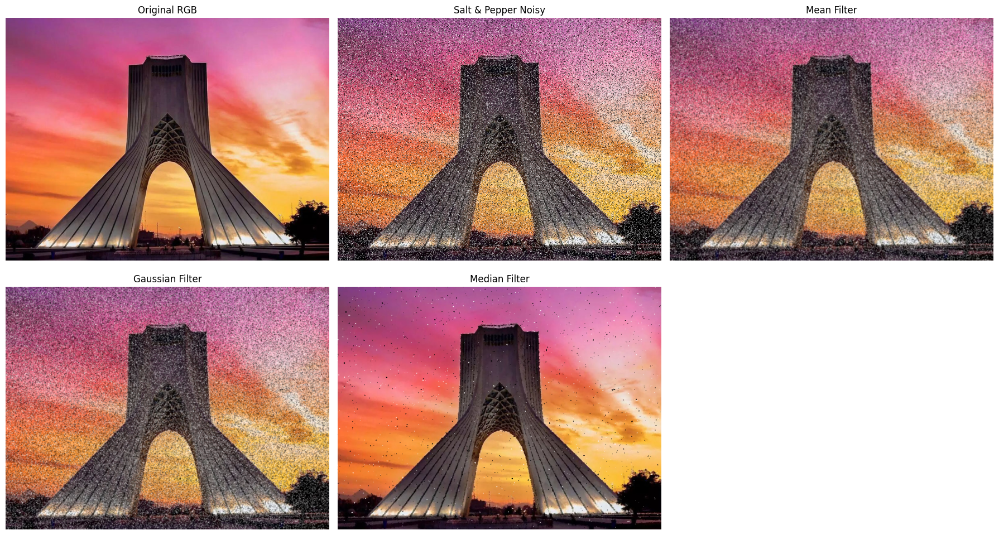

In [12]:
mean_filtered = cv2.blur(salt_and_pepper_noisy_image, (3, 3))
gaussian_filtered = cv2.GaussianBlur(salt_and_pepper_noisy_image, (3, 3), sigmaX=1)
median_filtered = cv2.medianBlur(salt_and_pepper_noisy_image, 3)



plt.figure(figsize=(18, 10))

plt.subplot(2, 3, 1)
plt.imshow(rgb_image)
plt.title("Original RGB")
plt.axis('off')

plt.subplot(2, 3, 2)
plt.imshow(salt_and_pepper_noisy_image)
plt.title("Salt & Pepper Noisy")
plt.axis('off')

plt.subplot(2, 3, 3)
plt.imshow(mean_filtered)
plt.title("Mean Filter")
plt.axis('off')

plt.subplot(2, 3, 4)
plt.imshow(gaussian_filtered)
plt.title("Gaussian Filter")
plt.axis('off')

plt.subplot(2, 3, 5)
plt.imshow(median_filtered)
plt.title("Median Filter")
plt.axis('off')

plt.tight_layout()
plt.show()

<div dir="rtl">
همانطور که در خلاصه هر فیلتر گفته شده بود نویز رو بهتر از همه Median Filter حذف کرد و در بازسازی عکس اول به ما کمک کرد.


#### Manual

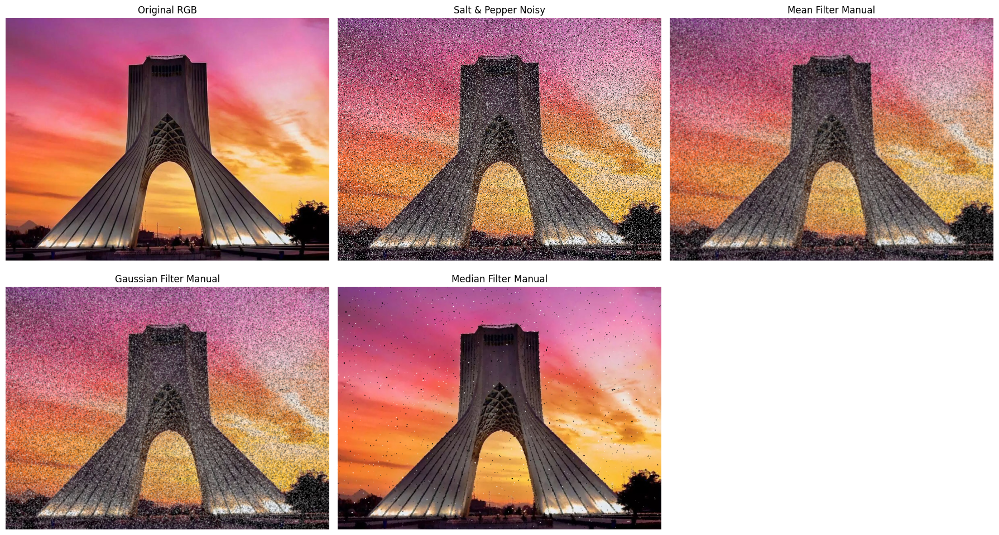

In [13]:
mean_filtered_manual = manual_mean_filter_rgb(salt_and_pepper_noisy_image, 3)
gaussian_filtered_manual = manual_filter_rgb(salt_and_pepper_noisy_image, kernel_gaussian)
median_filtered_manual = manual_median_filter_rgb(salt_and_pepper_noisy_image, 3)

plt.figure(figsize=(18, 10))

plt.subplot(2, 3, 1)
plt.imshow(rgb_image)
plt.title("Original RGB")
plt.axis('off')

plt.subplot(2, 3, 2)
plt.imshow(salt_and_pepper_noisy_image)
plt.title("Salt & Pepper Noisy")
plt.axis('off')

plt.subplot(2, 3, 3)
plt.imshow(mean_filtered_manual)
plt.title("Mean Filter Manual")
plt.axis('off')

plt.subplot(2, 3, 4)
plt.imshow(gaussian_filtered_manual)
plt.title("Gaussian Filter Manual")
plt.axis('off')

plt.subplot(2, 3, 5)
plt.imshow(median_filtered_manual)
plt.title("Median Filter Manual")
plt.axis('off')

plt.tight_layout()
plt.show()

### Gaussian Noise

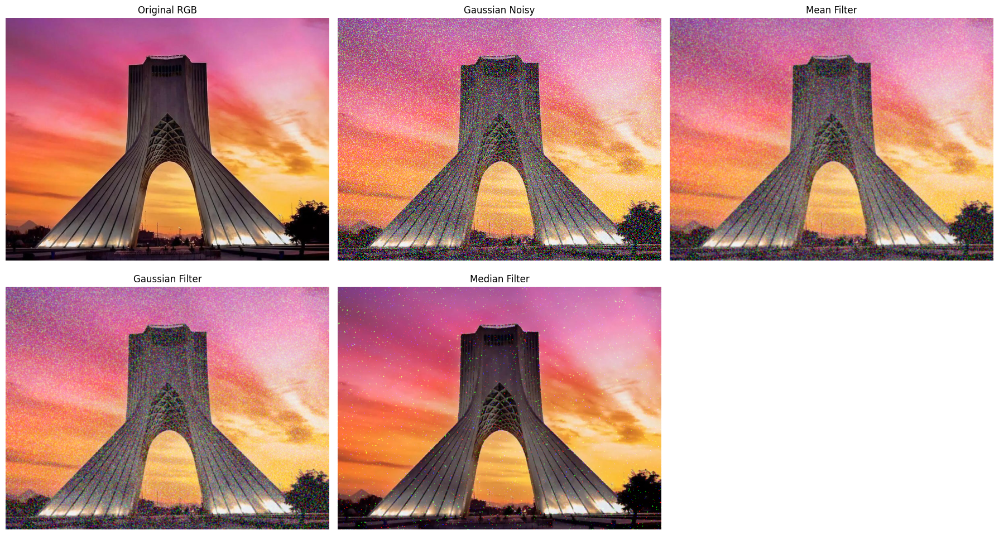

In [14]:
mean_filtered = cv2.blur(gaussian_noisy_image, (3, 3))
gaussian_filtered = cv2.GaussianBlur(gaussian_noisy_image, (3, 3), sigmaX=1)
median_filtered = cv2.medianBlur(gaussian_noisy_image, 3)



plt.figure(figsize=(18, 10))

plt.subplot(2, 3, 1)
plt.imshow(rgb_image)
plt.title("Original RGB")
plt.axis('off')

plt.subplot(2, 3, 2)
plt.imshow(gaussian_noisy_image)
plt.title("Gaussian Noisy")
plt.axis('off')

plt.subplot(2, 3, 3)
plt.imshow(mean_filtered)
plt.title("Mean Filter")
plt.axis('off')

plt.subplot(2, 3, 4)
plt.imshow(gaussian_filtered)
plt.title("Gaussian Filter")
plt.axis('off')

plt.subplot(2, 3, 5)
plt.imshow(median_filtered)
plt.title("Median Filter")
plt.axis('off')

plt.tight_layout()
plt.show()

#### Manual

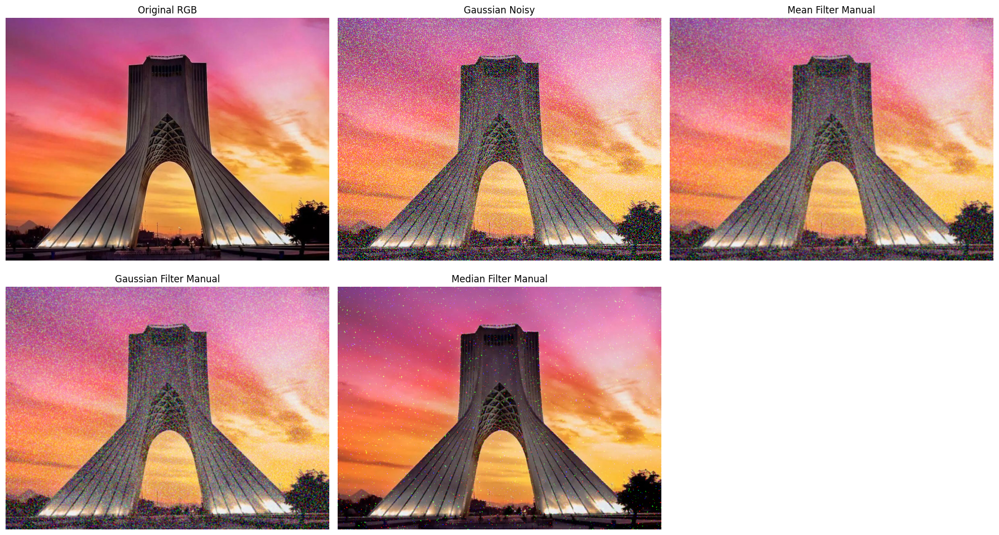

In [15]:
mean_filtered_manual = manual_mean_filter_rgb(gaussian_noisy_image, 3)
gaussian_filtered_manual = manual_filter_rgb(gaussian_noisy_image, kernel_gaussian)
median_filtered_manual = manual_median_filter_rgb(gaussian_noisy_image, 3)

plt.figure(figsize=(18, 10))

plt.subplot(2, 3, 1)
plt.imshow(rgb_image)
plt.title("Original RGB")
plt.axis('off')

plt.subplot(2, 3, 2)
plt.imshow(gaussian_noisy_image)
plt.title("Gaussian Noisy")
plt.axis('off')

plt.subplot(2, 3, 3)
plt.imshow(mean_filtered_manual)
plt.title("Mean Filter Manual")
plt.axis('off')

plt.subplot(2, 3, 4)
plt.imshow(gaussian_filtered_manual)
plt.title("Gaussian Filter Manual")
plt.axis('off')

plt.subplot(2, 3, 5)
plt.imshow(median_filtered_manual)
plt.title("Median Filter Manual")
plt.axis('off')

plt.tight_layout()
plt.show()

## Canny Filter

<div dir="rtl" >

مفهوم:

* الگوریتم Canny یک الگوریتم چندمرحله‌ای برای تشخیص لبه است که طراحی شده تا:

  * لبه‌ها را به‌صورت دقیق تشخیص دهد
  * تشخیص‌های اشتباه ناشی از نویز را کاهش دهد
* کاربرد گسترده دارد چون لبه‌های باریک و پیوسته تولید می‌کند و تغییرات کوچک شدت را نادیده می‌گیرد.

مراحل الگوریتم به تفصیل:

Gaussian Smoothing:

* قبل از تشخیص لبه، تصویر با فیلتر گوسی صاف می‌شود تا نویز کاهش یابد.
* کرنل:

$$[
G(x, y) = \frac{1}{2 \pi \sigma^2} e^{-\frac{x^2 + y^2}{2\sigma^2}}
]$$

* `σ` میزان صاف‌سازی را کنترل می‌کند.
* σ بزرگ‌تر → صاف‌سازی قوی‌تر → لبه‌های کاذب کمتر، اما احتمال از دست رفتن لبه‌های ظریف بیشتر.


محاسبه گرادیان (Gradient Calculation):

* گرادیان‌های شدت تصویر در جهت X و Y محاسبه می‌شوند، معمولاً با کرنل‌های Sobel:

$$[
G_x =
\begin{bmatrix}
-1 & 0 & 1 \newline
-2 & 0 & 2 \newline
-1 & 0 & 1
\end{bmatrix},
\quad
G_y =
\begin{bmatrix}
-1 & -2 & -1 \newline
0 & 0 & 0 \newline
1 & 2 & 1
\end{bmatrix}
]$$

* بزرگی و جهت گرادیان محاسبه می‌شود:

$$[
\text{Magnitude} = \sqrt{G_x^2 + G_y^2}, \quad \theta = \arctan\frac{G_y}{G_x}
]$$

* این مرحله مشخص می‌کند کجا لبه‌ها قوی‌تر هستند.

Non-Maximum Suppression:

* لبه‌ها را باریک می‌کند و فقط حداکثر محلی در جهت گرادیان را نگه می‌دارد.
* نتیجه: لبه‌های یک پیکسل عرض.

Double Thresholding:

* دو آستانه: پایین و بالا
* لبه‌های قوی (بزرگ‌تر از آستانه بالا) → قطعاً لبه
* لبه‌های ضعیف (بین دو آستانه) → ممکن است لبه باشند
* کمتر از آستانه پایین → حذف می‌شوند

Edge Tracking by Hysteresis:

* لبه‌های ضعیفی که به لبه‌های قوی متصل هستند نگه داشته می‌شوند، بقیه حذف می‌شوند.
* این کار تضمین می‌کند که لبه‌ها پیوسته و دقیق باشند و نویز نادیده گرفته شود.


روی تصاویر RGB:

* Canny می‌تواند برای هر کانال جداگانه اعمال شود، یا معمولاً تصویر به خاکستری تبدیل می‌شود.
* اگر روی کانال‌های RGB جداگانه اعمال شود، می‌توان نتایج را ترکیب کرد، ولی معمولاً نسخه خاکستری کافی است.

خلاصه مراحل:

| مرحله                | هدف                      | کرنل/روش                |
| -------------------- | ------------------------ | ----------------------- |
| Gaussian Smoothing   | کاهش نویز                | کرنل گوسی               |
| Gradient Calculation | یافتن لبه‌ها             | کرنل‌های Sobel          |
| Non-Max Suppression  | باریک کردن لبه‌ها        | بررسی حداکثر محلی       |
| Double Threshold     | شناسایی لبه‌های قوی/ضعیف | آستانه‌گذاری            |
| Hysteresis           | اتصال لبه‌ها             | وصل لبه‌های ضعیف به قوی |

* مزایا: دقیق، باریک، حساسیت کمتر به نویز
* معایب: نسبت به Sobel/Laplacian محاسبات سنگین‌تر


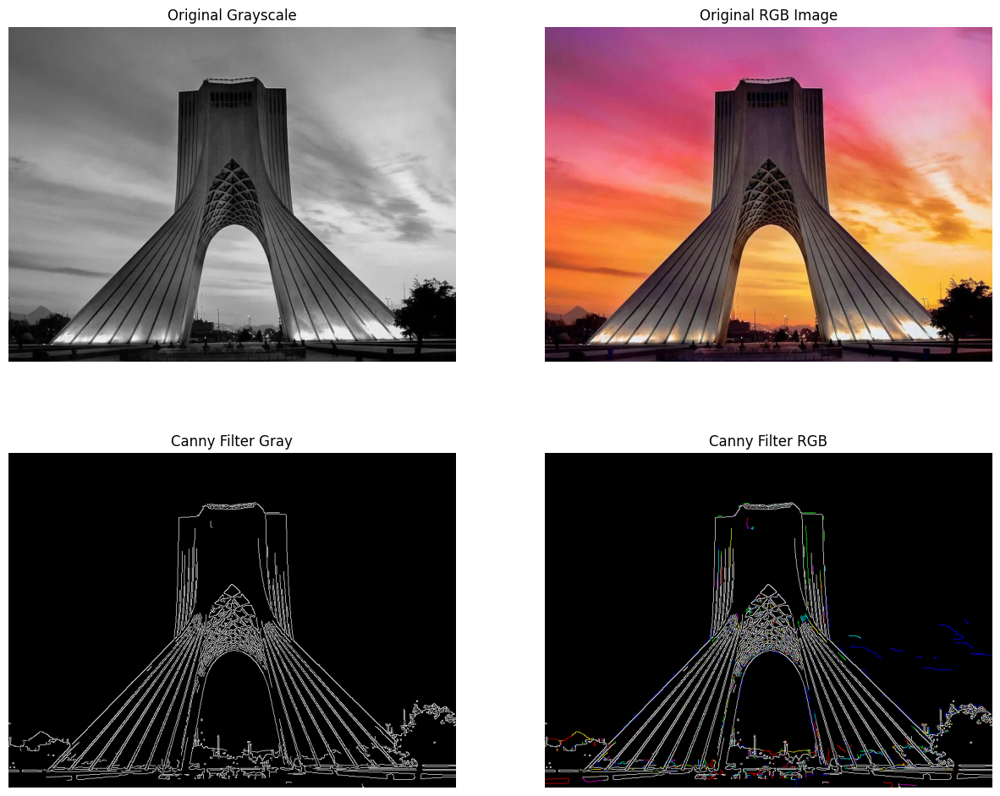

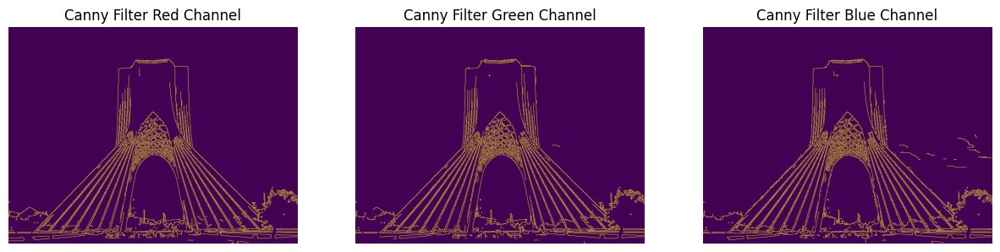

In [16]:
canny_gray = cv2.Canny(gray_image, 100, 200)
canny_rgb_r = cv2.Canny(rgb_image[:, :, 0], 100, 200)
canny_rgb_g = cv2.Canny(rgb_image[:, :, 1], 100, 200)
canny_rgb_b = cv2.Canny(rgb_image[:, :, 2], 100, 200)
canny_rgb = cv2.merge([canny_rgb_r, canny_rgb_g, canny_rgb_b])

plt.figure(figsize=(15, 12))
plt.subplot(2, 2, 1)
plt.imshow(gray_image, cmap='gray')
plt.title("Original Grayscale")
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(rgb_image, cmap='gray')
plt.title("Original RGB Image")
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(canny_gray, cmap='gray')
plt.title("Canny Filter Gray")
plt.axis('off')


plt.subplot(2, 2, 4)
plt.imshow(canny_rgb)
plt.title("Canny Filter RGB")
plt.axis('off')
plt.show()

plt.figure(figsize=(15, 12))

plt.subplot(1, 3, 1)
plt.imshow(canny_rgb_r)
plt.title("Canny Filter Red Channel")
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(canny_rgb_g)
plt.title("Canny Filter Green Channel")
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(canny_rgb_b)
plt.title("Canny Filter Blue Channel")
plt.axis('off')

plt.show()

### Manual

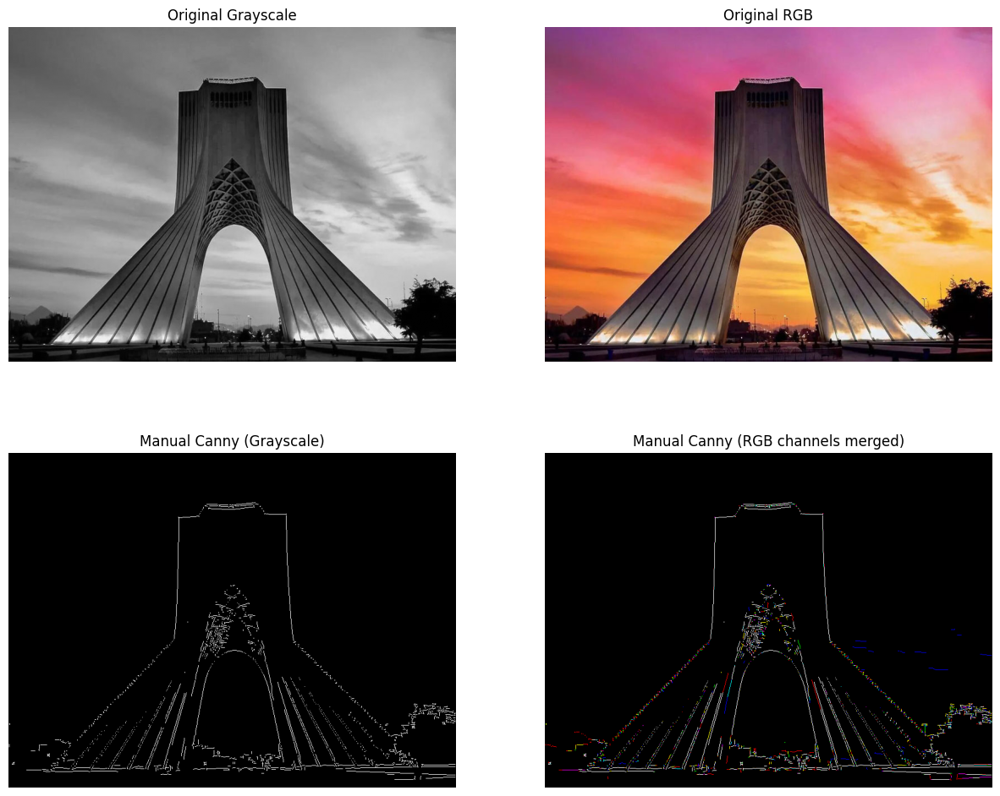

In [22]:
def manual_filter_gray(image, kernel):
    k = kernel.shape[0]
    pad = k // 2

    # Float32 to avoid overflow
    image = image.astype(np.float32)

    padded = np.pad(image, pad, mode='edge')
    output = np.zeros_like(image, dtype=np.float32)

    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            region = padded[i:i+k, j:j+k]
            output[i, j] = np.sum(region * kernel)

    return output



def gaussian_kernel(size=5, sigma=1):
    ax = np.arange(-size//2 + 1., size//2 + 1.)
    xx, yy = np.meshgrid(ax, ax)
    kernel = np.exp(-(xx**2 + yy**2) / (2 * sigma**2))
    return kernel / np.sum(kernel)


def sobel_filters(image):
    Kx = np.array([[-1,0,1], [-2,0,2], [-1,0,1]])
    Ky = np.array([[-1,-2,-1], [0,0,0], [1,2,1]])

    pad = 1
    image = image.astype(np.float32)
    padded = np.pad(image, pad, mode='edge')

    Gx = np.zeros_like(image, dtype=np.float32)
    Gy = np.zeros_like(image, dtype=np.float32)

    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            region = padded[i:i+3, j:j+3]
            Gx[i,j] = np.sum(region * Kx)
            Gy[i,j] = np.sum(region * Ky)

    G = np.sqrt(Gx**2 + Gy**2)
    theta = np.arctan2(Gy, Gx)
    return G, theta

def non_max_suppression(G, theta):
    Z = np.zeros_like(G)
    angle = theta * 180. / np.pi
    angle[angle < 0] += 180

    for i in range(1, G.shape[0]-1):
        for j in range(1, G.shape[1]-1):
            q = r = 255

            # Angle ranges
            if (0 <= angle[i,j] < 22.5) or (157.5 <= angle[i,j] <= 180):
                q = G[i, j+1]
                r = G[i, j-1]
            elif (22.5 <= angle[i,j] < 67.5):
                q = G[i+1, j-1]
                r = G[i-1, j+1]
            elif (67.5 <= angle[i,j] < 112.5):
                q = G[i+1, j]
                r = G[i-1, j]
            elif (112.5 <= angle[i,j] < 157.5):
                q = G[i-1, j-1]
                r = G[i+1, j+1]

            Z[i,j] = G[i,j] if (G[i,j] >= q and G[i,j] >= r) else 0

    return Z


def double_threshold(img, low, high):
    strong, weak = 255, 75
    res = np.zeros_like(img)

    strong_i, strong_j = np.where(img >= high)
    weak_i, weak_j = np.where((img <= high) & (img >= low))

    res[strong_i, strong_j] = strong
    res[weak_i, weak_j] = weak

    return res


def hysteresis(img):
    strong, weak = 255, 75

    for i in range(1, img.shape[0]-1):
        for j in range(1, img.shape[1]-1):
            if img[i,j] == weak:
                if 255 in img[i-1:i+2, j-1:j+2]:
                    img[i,j] = strong
                else:
                    img[i,j] = 0

    return img


def manual_canny(image, low=50, high=150):
    kernel = gaussian_kernel(size=5, sigma=1)

    smoothed = manual_filter_gray(image, kernel)
    G, theta = sobel_filters(smoothed)
    nms = non_max_suppression(G, theta)
    thresholded = double_threshold(nms, low, high)
    edges = hysteresis(thresholded)

    return edges.astype(np.uint8)


gray_image = gray_image.astype(np.float32)
rgb_image = rgb_image.astype(np.float32)

canny_gray_manual = manual_canny(gray_image)

canny_rgb_manual = np.zeros_like(rgb_image)
for c in range(3):
    canny_rgb_manual[:, :, c] = manual_canny(rgb_image[:, :, c])

plt.figure(figsize=(15, 12))

plt.subplot(2, 2, 1)
plt.imshow(gray_image, cmap='gray')
plt.title("Original Grayscale")
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(rgb_image.astype(np.uint8))
plt.title("Original RGB")
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(canny_gray_manual, cmap='gray')
plt.title("Manual Canny (Grayscale)")
plt.axis('off')

plt.subplot(2, 2, 4)
plt.imshow(canny_rgb_manual.astype(np.uint8))
plt.title("Manual Canny (RGB channels merged)")
plt.axis('off')

plt.show()


## Sobel Filter

<div dir="rtl" >

مفهوم

فیلتر سوبل یک اپراتور تشخیص لبه است که مشتق اول شدت پیکسل‌ها را در تصویر محاسبه می‌کند.
این فیلتر لبه‌ها را با یافتن تغییرات سریع در شدت پیکسل‌ها تشخیص می‌دهد.

دو جهت اصلی وجود دارد:

* جهت X: لبه‌های افقی / تغییرات عمودی شدت
* جهت Y: لبه‌های عمودی / تغییرات افقی شدت

کرنل‌ها:

Sobel X (تشخیص لبه‌های عمودی):

$$[
G_x =
\begin{bmatrix}
-1 & 0 & 1 \newline
-2 & 0 & 2 \newline
-1 & 0 & 1
\end{bmatrix}
]$$

* هر پیکسل با جمع وزن‌دار همسایگانش جایگزین می‌شود.
* تمرکز: تغییرات عمودی شدت → لبه‌های عمودی تصویر


Sobel Y (تشخیص لبه‌های افقی):

$$[
G_y =
\begin{bmatrix}
-1 & -2 & -1 \newline
0 & 0 & 0 \newline
1 & 2 & 1
\end{bmatrix}
]$$

* تمرکز: تغییرات افقی شدت → لبه‌های افقی تصویر

بزرگی گرادیان (Gradient Magnitude):

پس از اعمال هر دو کرنل، آن‌ها را ترکیب می‌کنیم تا قدرت لبه کل تصویر را بدست آوریم:

$$[
G = \sqrt{G_x^2 + G_y^2}
]$$


* نتیجه تصویری است که پیکسل‌های روشن → لبه‌های قوی و پیکسل‌های تیره → مناطق صاف را نشان می‌دهد.

اثر:

* لبه‌ها را در مناطقی که شدت سریع تغییر می‌کند برجسته می‌کند.
* جهتی: می‌تواند لبه‌ها را در جهت X یا Y به‌صورت جداگانه یا ترکیبی تشخیص دهد.
* ساده و سریع است، اما حساس به نویز است (تغییرات کوچک تصادفی ممکن است به‌عنوان لبه تشخیص داده شوند).


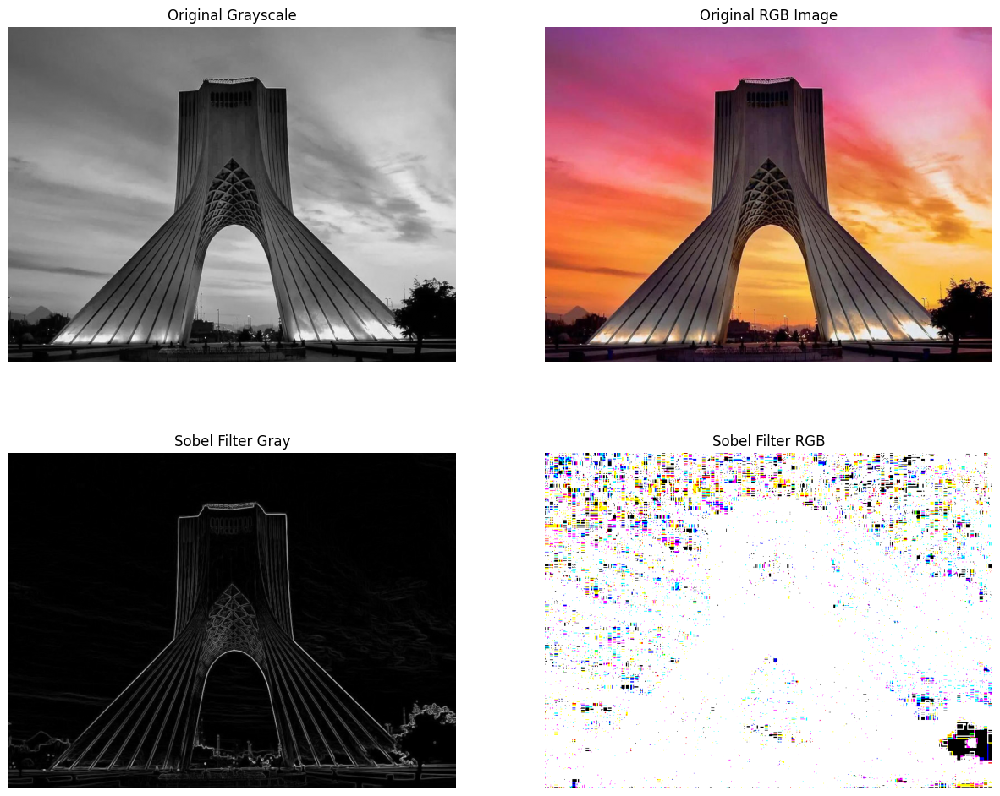

In [18]:
sobel_x_gray = cv2.Sobel(gray_image, cv2.CV_64F, 1, 0, ksize=3)
sobel_y_gray = cv2.Sobel(gray_image, cv2.CV_64F, 0, 1, ksize=3)
sobel_gray = cv2.magnitude(sobel_x_gray, sobel_y_gray)

sobel_x_rgb = cv2.Sobel(rgb_image, cv2.CV_64F, 1, 0, ksize=3)
sobel_y_rgb = cv2.Sobel(rgb_image, cv2.CV_64F, 0, 1, ksize=3)
sobel_rgb = cv2.magnitude(sobel_x_rgb, sobel_y_rgb)


plt.figure(figsize=(15, 12))
plt.subplot(2, 2, 1)
plt.imshow(gray_image, cmap='gray')
plt.title("Original Grayscale")
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(rgb_image, cmap='gray')
plt.title("Original RGB Image")
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(sobel_gray, cmap='gray')
plt.title("Sobel Filter Gray")
plt.axis('off')


plt.subplot(2, 2, 4)
plt.imshow(sobel_rgb)
plt.title("Sobel Filter RGB")
plt.axis('off')
plt.show()

### Manual

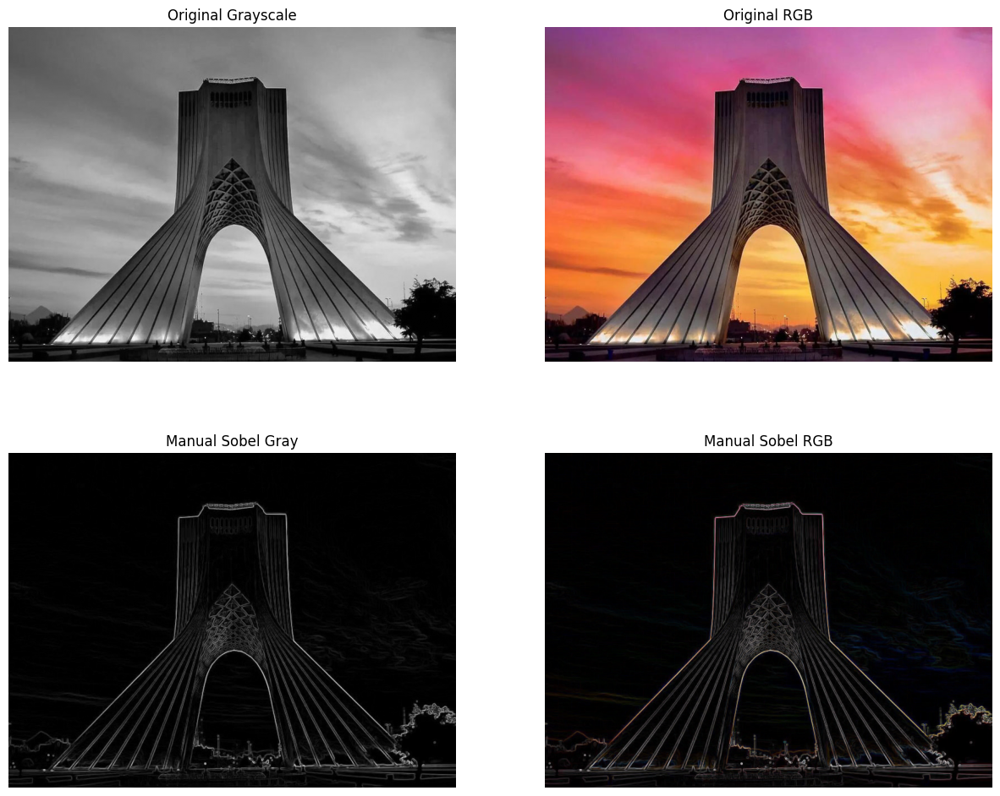

In [23]:
sobel_x_kernel = np.array([[-1, 0, 1],
                           [-2, 0, 2],
                           [-1, 0, 1]], dtype=np.float32)

sobel_y_kernel = np.array([[-1, -2, -1],
                           [0, 0, 0],
                           [1, 2, 1]], dtype=np.float32)

def manual_sobel_gray(image, kx, ky):
    pad = 1
    padded = np.pad(image, pad, mode='edge')
    gx = np.zeros_like(image, dtype=np.float32)
    gy = np.zeros_like(image, dtype=np.float32)

    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            region = padded[i:i+3, j:j+3]
            gx[i,j] = np.sum(region * kx)
            gy[i,j] = np.sum(region * ky)

    magnitude = np.sqrt(gx**2 + gy**2)

    magnitude = (magnitude / magnitude.max()) * 255
    return magnitude.astype(np.uint8)

def manual_sobel_rgb(image, kx, ky):
    output = np.zeros_like(image, dtype=np.uint8)
    for c in range(3):
        output[:, :, c] = manual_sobel_gray(image[:, :, c], kx, ky)
    return output

sobel_gray_manual = manual_sobel_gray(gray_image, sobel_x_kernel, sobel_y_kernel)
sobel_rgb_manual = manual_sobel_rgb(rgb_image, sobel_x_kernel, sobel_y_kernel)

plt.figure(figsize=(15, 12))

plt.subplot(2, 2, 1)
plt.imshow(gray_image, cmap='gray')
plt.title("Original Grayscale")
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(rgb_image.astype(np.uint8))
plt.title("Original RGB")
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(sobel_gray_manual, cmap='gray')
plt.title("Manual Sobel Gray")
plt.axis('off')

plt.subplot(2, 2, 4)
plt.imshow(sobel_rgb_manual.astype(np.uint8))
plt.title("Manual Sobel RGB")
plt.axis('off')

plt.show()


## Laplacian Filter

<div dir="rtl">

مفهوم:

* فیلتر Laplacian یک اپراتور مشتق دوم در پردازش تصویر است.
* لبه‌ها را در مناطقی که شدت پیکسل‌ها سریع تغییر می‌کند تشخیص می‌دهد.
* بر خلاف Sobel (مشتق اول) که تغییرات در X یا Y را جداگانه بررسی می‌کند، Laplacian تمام تغییرات شدت در همه جهات را هم‌زمان تشخیص می‌دهد.

کرنل‌ها:

کرنل ۳×۳ لاپلاسین (۴ همسایه):

$$[
K_{laplacian} =
\begin{bmatrix}
0 & 1 & 0 \newline
1 & -4 & 1 \newline
0 & 1 & 0
\end{bmatrix}
]$$

* فقط همسایه‌های عمودی و افقی را بررسی می‌کند.
* لبه‌ها را در هر دو محور برجسته می‌کند.

کرنل ۳×۳ لاپلاسین (۸ همسایه):

$$[
K_{laplacian} =
\begin{bmatrix}
1 & 1 & 1 \newline
1 & -8 & 1 \newline
1 & 1 & 1
\end{bmatrix}
]$$

* شامل همسایه‌های مورب نیز می‌شود.
* لبه‌ها را در تمام جهات با شدت بیشتری تشخیص می‌دهد.


مفهوم ریاضی:

* فرمول اپراتور لاپلاسین:

$$[
\nabla^2 I = \frac{\partial^2 I}{\partial x^2} + \frac{\partial^2 I}{\partial y^2}
]$$

* برای هر پیکسل، فیلتر مجموع مشتقات دوم در جهت X و Y را محاسبه می‌کند.
* پیکسل‌های روشن در خروجی → تغییرات شدت قوی → لبه‌ها.

اثر:

* لبه‌ها را در تمام جهات برجسته می‌کند.
* حساس به نویز: تغییرات کوچک شدت نیز به‌عنوان لبه ظاهر می‌شوند.


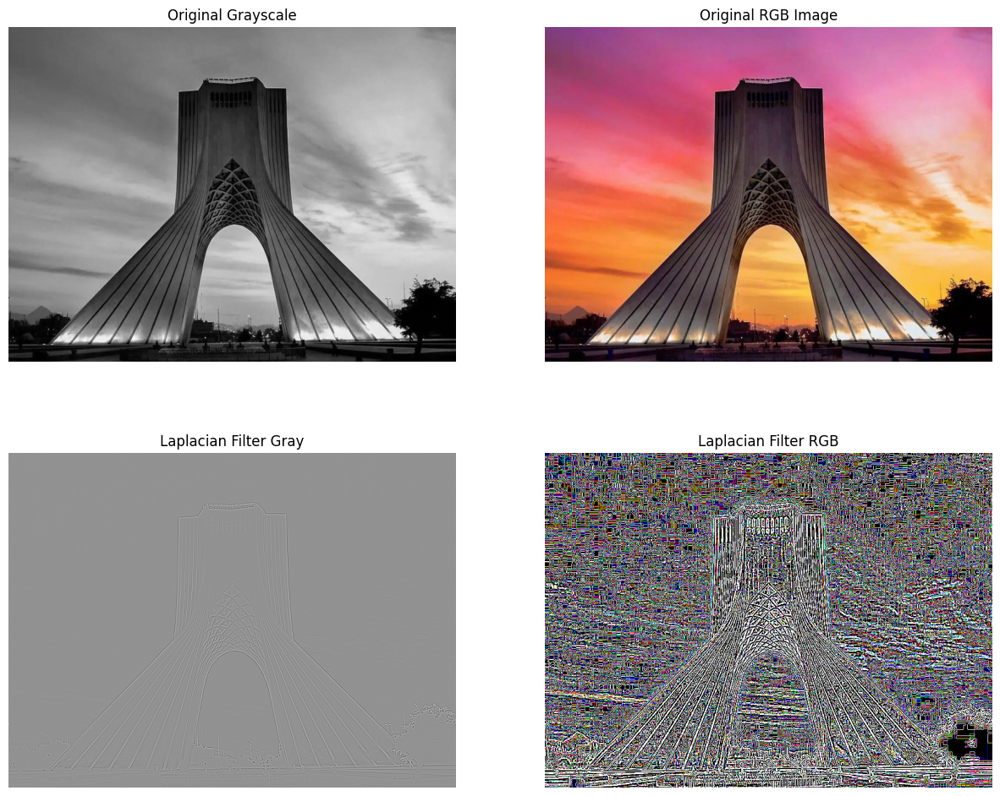

In [20]:
laplacian_gray = cv2.Laplacian(gray_image, cv2.CV_64F)
laplacian_rgb = cv2.Laplacian(rgb_image, cv2.CV_64F)

plt.figure(figsize=(15, 12))
plt.subplot(2, 2, 1)
plt.imshow(gray_image, cmap='gray')
plt.title("Original Grayscale")
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(rgb_image, cmap='gray')
plt.title("Original RGB Image")
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(laplacian_gray, cmap='gray')
plt.title("Laplacian Filter Gray")
plt.axis('off')


plt.subplot(2, 2, 4)
plt.imshow(laplacian_rgb)
plt.title("Laplacian Filter RGB")
plt.axis('off')
plt.show()

### Manual

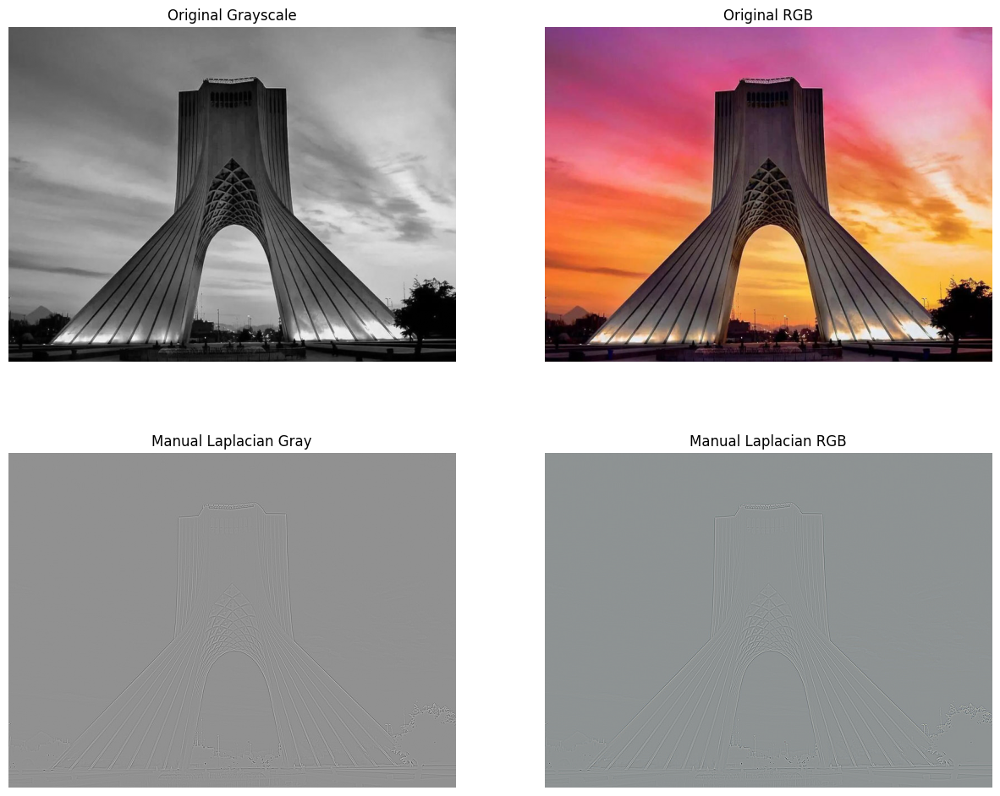

In [24]:
laplacian_kernel = np.array([[0, 1, 0],
                             [1,-4, 1],
                             [0, 1, 0]], dtype=np.float32)

def manual_laplacian_gray(image, kernel):
    ksize = kernel.shape[0]
    pad = ksize // 2
    padded = np.pad(image, pad, mode='edge')
    output = np.zeros_like(image, dtype=np.float32)

    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            region = padded[i:i+ksize, j:j+ksize]
            output[i,j] = np.sum(region * kernel)

    output = output - output.min()
    output = (output / output.max()) * 255
    return output.astype(np.uint8)

def manual_laplacian_rgb(image, kernel):
    output = np.zeros_like(image, dtype=np.uint8)
    for c in range(3):
        output[:,:,c] = manual_laplacian_gray(image[:,:,c], kernel)
    return output

laplacian_gray_manual = manual_laplacian_gray(gray_image, laplacian_kernel)
laplacian_rgb_manual = manual_laplacian_rgb(rgb_image, laplacian_kernel)

plt.figure(figsize=(15, 12))

plt.subplot(2, 2, 1)
plt.imshow(gray_image, cmap='gray')
plt.title("Original Grayscale")
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(rgb_image.astype(np.uint8))
plt.title("Original RGB")
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(laplacian_gray_manual, cmap='gray')
plt.title("Manual Laplacian Gray")
plt.axis('off')

plt.subplot(2, 2, 4)
plt.imshow(laplacian_rgb_manual.astype(np.uint8))
plt.title("Manual Laplacian RGB")
plt.axis('off')

plt.show()
